In [1]:
# Import all modules; make sure notebook can be run
import numpy as np
import cv2
import pickle
import os
import matplotlib.pyplot as plt
from moviepy.editor import VideoFileClip
from IPython.display import HTML

%matplotlib inline 

#### Camera Calibration ####
** 1. Briefly state how you computed the camera matrix and distortion coefficients. Provide an example of a distortion corrected calibration image. **

I have used the code from the udacity lessons along with the chessboard images provided. First I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the   chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image.  Thus, `objp` is just a   replicated array of coordinates, and `objpoints` will be appended with a copy of it every time I successfully detect all chessboard corners in a test image.  `imgpoints` will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful      chessboard detection.

I then used the output `objpoints` and `imgpoints` to compute the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` function.  I applied this distortion correction to the test image using the `cv2.undistort()` function and obtained the results shown in the cell below.

In [2]:
cal_images = os.popen("ls camera_cal/cal*.jpg").read().strip().split("\n")
nx=9
ny=6
# Preparing object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((nx * ny, 3), np.float32)
objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)
objpoints = []
imgpoints = []

fig = plt.figure(figsize=(25,20))
for i, c in enumerate(cal_images):
    img = cv2.imread(cal_images[i])
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    # If found, draw corners
    ax = fig.add_subplot(5,4,i+1)
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
            
        # Draw and display the corners
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        plt.imshow(img);
        plt.axis('off')
        plt.title(c, fontsize=20)
    else:
        plt.imshow(img);
        plt.axis('off')
        plt.title(c, fontsize=20)

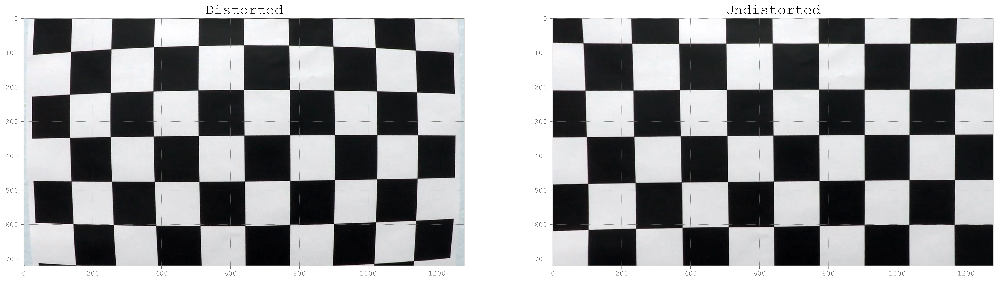

In [3]:
def undistort_image(image, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

"""
cal_images = os.popen("ls camera_cal/cal*.jpg").read().strip().split("\n")
for i, c in enumerate(cal_images):
    img = cv2.imread(c)
    img_size = (img.shape[1], img.shape[0])
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
    result = undistort_image(img, mtx, dist)
    cv2.imwrite('output_images/chessbord_undistort'+str(i)+'.jpg', result)
"""

# Test undistortion on an image
img = cv2.imread('camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
result = undistort_image(img, mtx, dist)
cv2.imwrite('camera_cal/test_undist.jpg',result)

# Plot the result
fig = plt.figure(figsize=(24, 9))
fig.add_subplot(1,2,1)
plt.imshow(img);
plt.title('Distorted', fontsize=20)
fig.add_subplot(1,2,2)
plt.imshow(result);
plt.title('Undistorted', fontsize=20);


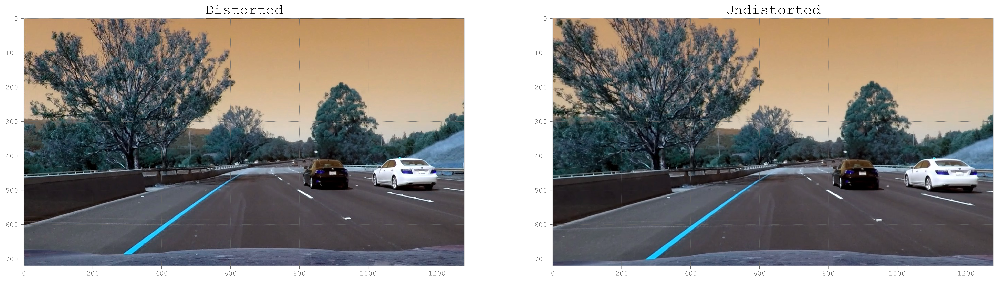

In [4]:
# Test undistortion on a road image
"""
idx=0
test_images = os.popen("ls test_images/test*.jpg").read().strip().split("\n")
for i, c in enumerate(test_images):
    img = cv2.imread(c)
    result = undistort_image(img, mtx, dist)
    cv2.imwrite('output_images/road_undistorted_res'+str(idx)+'.jpg', result)
"""

img = cv2.imread("test_images/test6.jpg")
result = undistort_image(img, mtx, dist)
# Plot the result
fig = plt.figure(figsize=(24, 9))
fig.add_subplot(1,2,1)
plt.imshow(img);
plt.title('Distorted', fontsize=20)
fig.add_subplot(1,2,2)
plt.imshow(result);
plt.title('Undistorted', fontsize=20);

The undistroted chess and test road images are saved in the output_images folder. 

#### Color Transformations ####
Applying a set of color transformations on the test road images to clearly identify the lane lines. Some transformations work better than the other and may be combined. The following cells show the different transformations being applied to ones of the test images. 

In [11]:
# function for sobel x or sobel y gradient.
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):    
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)   
    if orient == 'x':
        sobel_r = cv2.Sobel(gray, cv2.CV_64F, 1, 0, sobel_kernel)
    elif orient == 'y':
        sobel_r = cv2.Sobel(gray, cv2.CV_64F, 0, 1, sobel_kernel) 
        
    abs_sobel = np.absolute(sobel_r)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    return sxbinary

# function for overall magnitude of gradient
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, sobel_kernel)
    abs_sobel = np.sqrt(np.square(sobelx) + np.square(sobely))
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    
    return sxbinary
# function for color gradient
def hls_select(img, thresh=(0, 255)):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HLS).astype(np.float)
    S = hsv[:,:,2]   
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1    
    return binary

# Apply thresholding functions to the RGB component of the images
def red_channel(img, thresh=(0, 255)):
    channel = img[:, :, 0]
    binary = np.zeros_like(channel)
    binary[(channel >= thresh[0]) & (channel <= thresh[1])] = 1
    return binary

def green_channel(img, thresh=(0, 255)):
    channel = img[:, :, 1]
    binary = np.zeros_like(channel)
    binary[(channel >= thresh[0]) & (channel <= thresh[1])] = 1
    return binary

def blue_channel(img, thresh=(0, 255)):
    channel = img[:, :, 2]
    binary = np.zeros_like(channel)
    binary[(channel >= thresh[0]) & (channel <= thresh[1])] = 1
    return binary

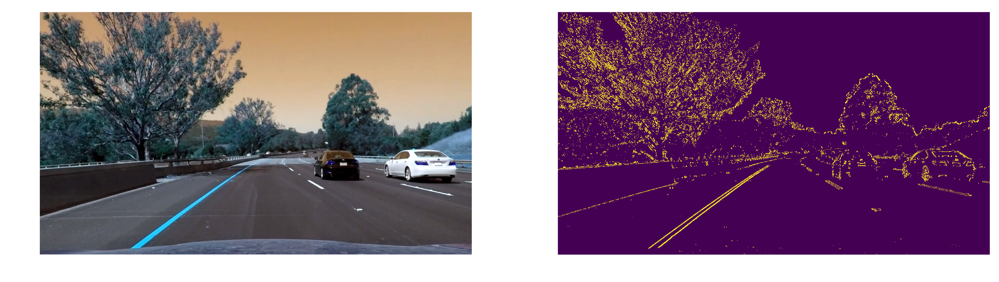

In [6]:
img = cv2.imread('test_images/test6.jpg')
dist_pickle = pickle.load( open( "camera_calibration.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]

step1 = undistort_image(img, mtx, dist)

ksize = 15 

# Apply each of the thresholding functions
gradx = abs_sobel_thresh(step1, orient='x', sobel_kernel=ksize, thresh=(20, 100))
grady = abs_sobel_thresh(step1, orient='y', sobel_kernel=ksize, thresh=(20, 100))
mag_binary = mag_thresh(step1, sobel_kernel=ksize, mag_thresh=(120, 160))

combined = np.zeros_like(mag_binary)
combined[((gradx == 1) & (grady == 1)) | (mag_binary == 1)] = 1

# Plot the result
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(step1);
plt.axis('off');

ax = fig.add_subplot(1,2,2)
plt.imshow(combined);
plt.axis('off');


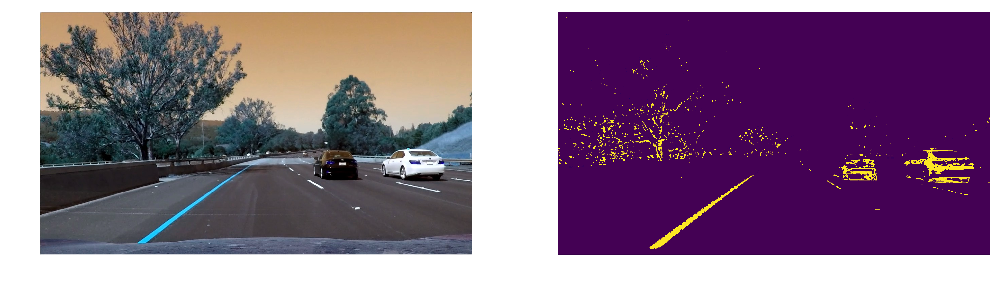

In [7]:
hls_binary = hls_select(step1, thresh=(150, 255))

# Plot the result
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(img);
plt.axis('off');

ax = fig.add_subplot(1,2,2)
plt.imshow(hls_binary);
plt.axis('off');

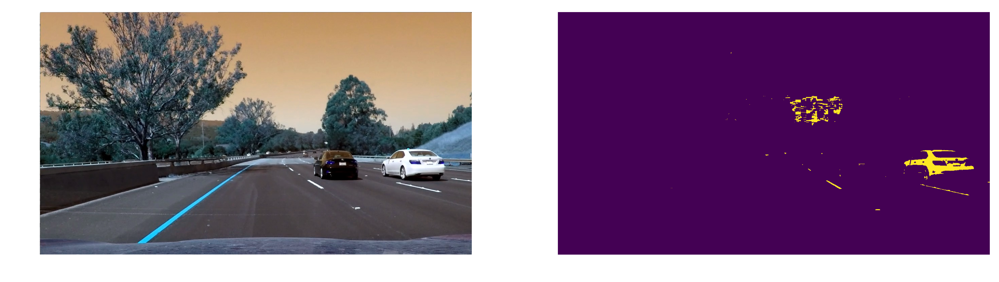

In [18]:
red_binary = red_channel(step1, thresh=(220, 255))

# Plot the result
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(img);
plt.axis('off');

ax = fig.add_subplot(1,2,2)
plt.imshow(red_binary);
plt.axis('off');

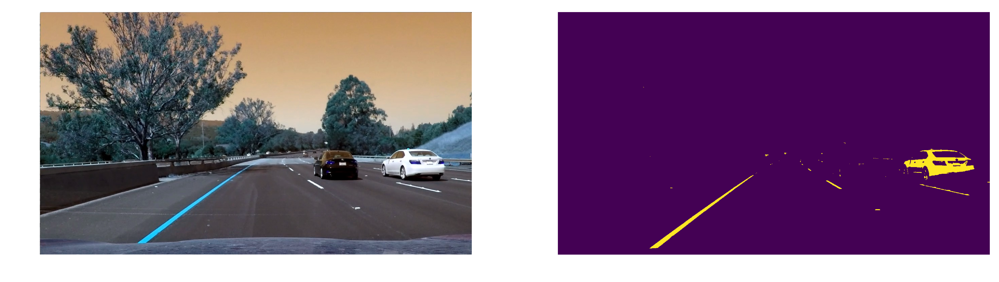

In [16]:
blue_binary = blue_channel(step1, thresh=(220, 255))

# Plot the result
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(img);
plt.axis('off');

ax = fig.add_subplot(1,2,2)
plt.imshow(blue_binary);
plt.axis('off');

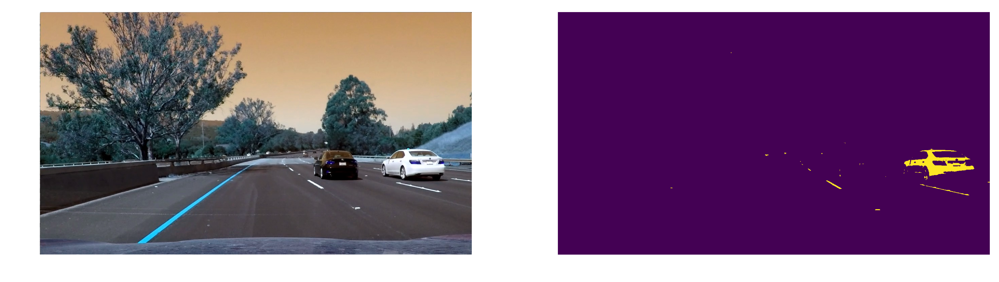

In [19]:
green_binary = green_channel(step1, thresh=(220, 255))

# Plot the result
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(img);
plt.axis('off');

ax = fig.add_subplot(1,2,2)
plt.imshow(green_binary);
plt.axis('off');

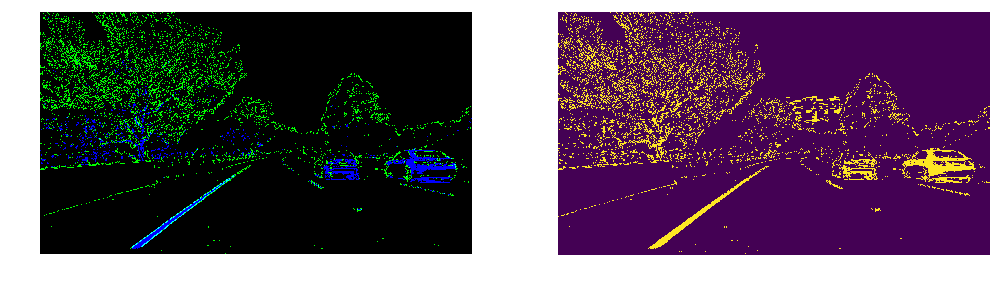

In [25]:
color_binary = np.dstack(( np.zeros_like(combined), combined, hls_binary))

# Combine the two binary thresholds
combined_binary = np.zeros_like(hls_binary)
combined_binary[(hls_binary == 1)|(green_binary == 1)|(red_binary == 1)|(combined == 1)] = 1

# Plotting thresholded images
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(color_binary);
plt.axis('off');

ax = fig.add_subplot(1,2,2)
plt.imshow(combined_binary);
plt.axis('off');


In [28]:
def pipeline(img, M):
    
    img_size = (img.shape[1], img.shape[0])
    
    dist_pickle = pickle.load( open( "camera_calibration.p", "rb" ) )
    mtx = dist_pickle["mtx"]
    dist = dist_pickle["dist"]

    step1 = undistort_image(img, mtx, dist)
    #step2 = cv2.cvtColor(step1, cv2.COLOR_BGR2GRAY)
    step3 = abs_sobel_thresh(step1, orient='x', sobel_kernel=15, thresh=(20, 100))
    step4 = abs_sobel_thresh(step1, orient='y', sobel_kernel=ksize, thresh=(20, 100))
    step5 = mag_thresh(step1, sobel_kernel=15, mag_thresh=(120, 160))

    grad_combined = np.zeros_like(step5)
    grad_combined[((step3 == 1) & (step4 == 1)) | (step5 == 1)] = 1
    
    step6 = hls_select(step1, thresh=(150, 255))
    step7 = red_channel(step1, thresh=(240, 255))
    step8 = green_channel(step1, thresh=(240, 255))
    
    combined_binary = np.zeros_like(grad_combined)
    combined_binary[(grad_combined == 1) | (step6 == 1)| (step7 == 1)|(step8 == 1)] = 1
     
    Mask_Img = np.zeros_like(combined_binary)
    vertices = np.array([[(180,img.shape[0]),
                          (610,440), (690,440), (1200,img.shape[0])]], dtype=np.int)
    cv2.fillPoly(Mask_Img, vertices, 1) #Fill a masked polygon
    
    masked = np.zeros_like(Mask_Img)
    masked[(combined_binary == 1) & (Mask_Img == 1)] = 1
    
    w = cv2.warpPerspective(masked, M, img_size)
    
    return w


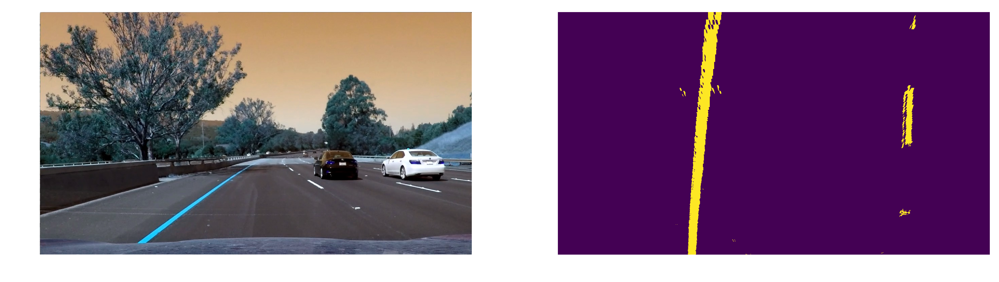

In [29]:
# Test existing pipeline on an image
img = cv2.imread('test_images/test6.jpg')

src = np.float32([[550,480],[740,480],[1050,680],[250,680]])     
dst = np.float32([[350,0],[980,0],[980,720],[350,720]])
        
M = cv2.getPerspectiveTransform(src, dst) 
Minv = cv2.getPerspectiveTransform(dst, src)

result = pipeline(img, M)

# Plot the result
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(img);
plt.axis('off');

ax = fig.add_subplot(1,2,2)
plt.imshow(result);
plt.axis('off');

Take the sum of the points in the second half of the image. This marks the position of the lane lines in the image when viewed from top down.

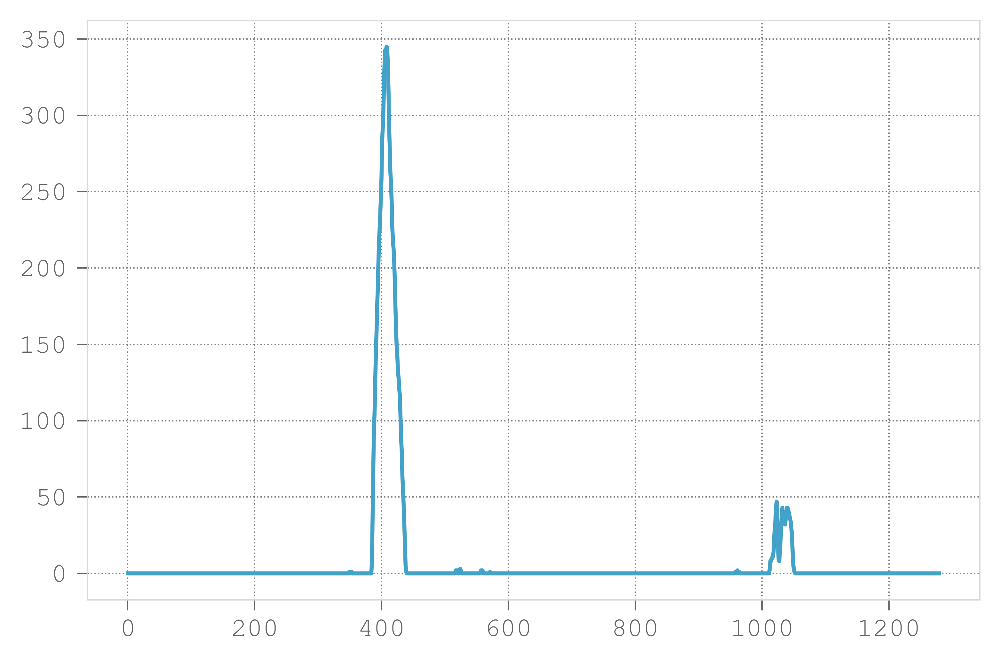

In [31]:
histogram = np.sum(result[360:,:], axis=0)
plt.plot(histogram);

Using the sliding window approach to fit 9 rectangles on the previously detected line image.

In [33]:
# Create an output image to draw on and  visualize the result
out_img = np.dstack((result, result, result))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines

midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(result.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = result.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = result.shape[0] - (window+1)*window_height
    win_y_high = result.shape[0] - window*window_height
    
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
    
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

# Generate x and y values for plotting
ploty = np.linspace(0, result.shape[0]-1, result.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

Having fitted a second order polynomial to the lines. Get the x,y values and plot the lines.

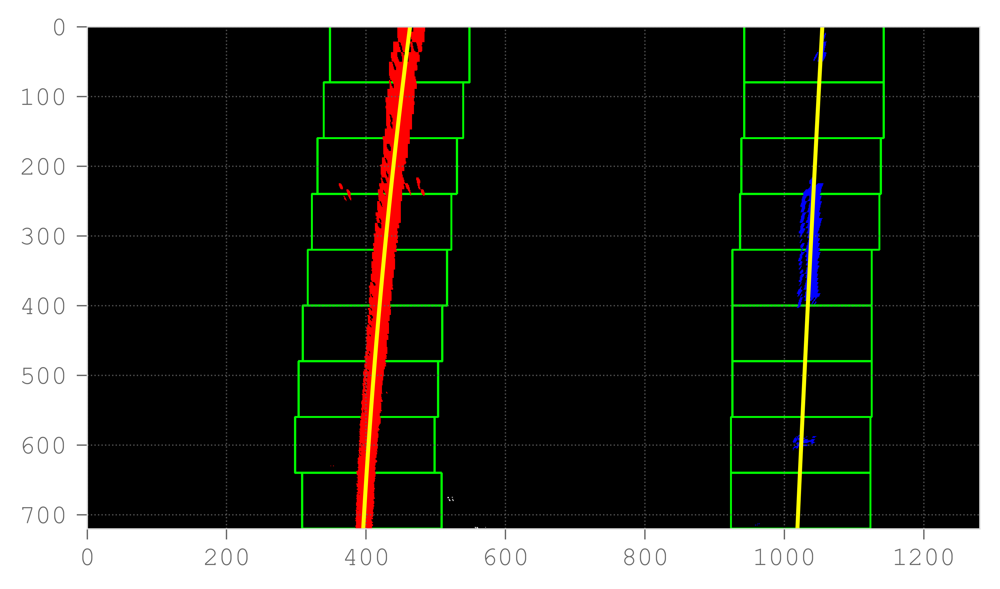

In [34]:
ploty = np.linspace(0, result.shape[0]-1, result.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0);

In [35]:
y_eval = np.mean(ploty)
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')


3282.32565499 m 22264.1581907 m


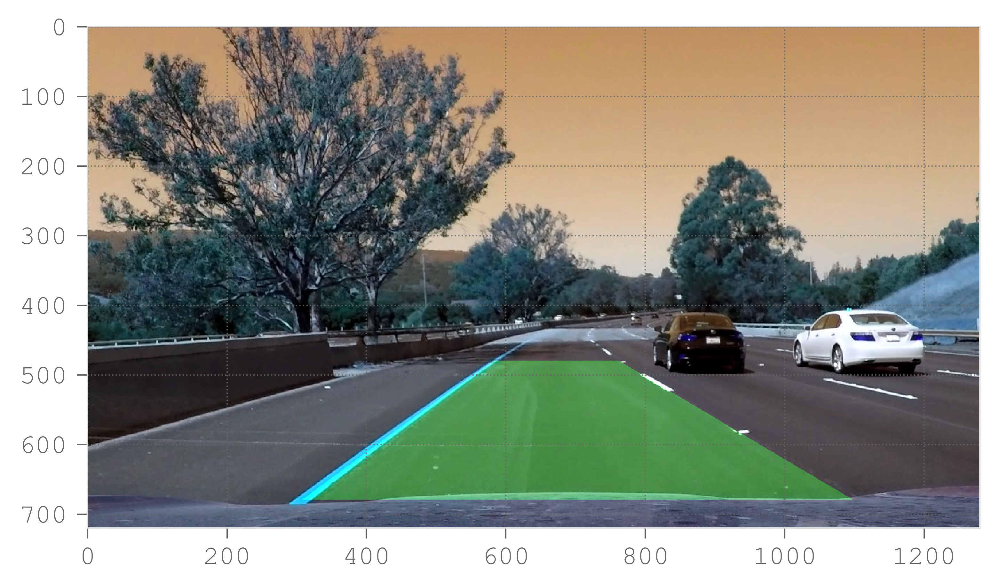

In [36]:
# Create an image to draw the lines on
warp_zero = np.zeros_like(result).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
# Combine the result with the original image
fresult = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
plt.imshow(fresult);

In [37]:
def pipeline(img):
    
    img_size = (img.shape[1], img.shape[0])
    
    img_size = (img.shape[1], img.shape[0])
    
    dist_pickle = pickle.load( open( "camera_calibration.p", "rb" ) )
    mtx = dist_pickle["mtx"]
    dist = dist_pickle["dist"]

    step1 = undistort_image(img, mtx, dist)
    #step2 = cv2.cvtColor(step1, cv2.COLOR_BGR2GRAY)
    step3 = abs_sobel_thresh(step1, orient='x', sobel_kernel=15, thresh=(20, 100))
    step4 = abs_sobel_thresh(step1, orient='y', sobel_kernel=ksize, thresh=(20, 100))
    step5 = mag_thresh(step1, sobel_kernel=15, mag_thresh=(120, 160))

    grad_combined = np.zeros_like(step5)
    grad_combined[((step3 == 1) & (step4 == 1)) | (step5 == 1)] = 1
    
    step6 = hls_select(step1, thresh=(150, 255))
    step7 = red_channel(step1, thresh=(240, 255))
    step8 = green_channel(step1, thresh=(240, 255))
    
    combined_binary = np.zeros_like(grad_combined)
    combined_binary[(grad_combined == 1) | (step6 == 1)| (step7 == 1)|(step8 == 1)] = 1
       
    Mask_Img = np.zeros_like(combined_binary)
    vertices = np.array([[(180,img.shape[0]),
                          (610,440), (690,440), (1200,img.shape[0])]], dtype=np.int)
    cv2.fillPoly(Mask_Img, vertices, 1) #Fill a masked polygon
    
    masked = np.zeros_like(Mask_Img)
    masked[(combined_binary == 1) & (Mask_Img == 1)] = 1
    
    w = cv2.warpPerspective(masked, M, img_size)
    
    histogram = np.sum(w[360:,:], axis=0)
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(w.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = w.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = w.shape[0] - (window+1)*window_height
        win_y_high = w.shape[0] - window*window_height
    
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
    
         # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
    
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, w.shape[0]-1, w.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    warp_zero = np.zeros_like(w).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))   

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
    # Combine the result with the original image
    fresult = cv2.addWeighted(img, 1, newwarp, 0.3, 0)    
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    y_eval = np.mean(ploty)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + 
                           left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + 
                            right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters

    a="Curvature left: " + str(left_curverad) + " right: " + str(right_curverad)
    cv2.putText(fresult,a,(400,50), cv2.FONT_HERSHEY_SIMPLEX, 1,(0,0,0),2)
  
    # Road position of vehicle
    xm_per_pix = 3.7/700
    left_lane_pos = left_fitx[len(left_fitx)-1]
    right_lane_pos = right_fitx[len(right_fitx)-1]
    road_pos = (((left_lane_pos + right_lane_pos) / 2) - 640) * xm_per_pix
    b="Road offset: " + str(road_pos)
    cv2.putText(fresult,b,(700,90), cv2.FONT_HERSHEY_SIMPLEX, 1,(0,0,0),2)
    
    return fresult

In [38]:
#src = np.float32([[550,480],[740,480],[1050,680],[250,680]])     
#dst = np.float32([[350,0],[980,0],[980,720],[350,720]])
src = np.float32([[620,450],[680,450],[1050,680],[250,680]])   
dst = np.float32([[590,0],[860,0],[900,720],[450,720]])
        
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)     

test_video = VideoFileClip("project_video.mp4")
annotated_video = "project_video_out.mp4"

test_output = test_video.fl_image(pipeline);
%time test_output.write_videofile(annotated_video, audio=False)

# Display output video
HTML("""
<video width="600" height="320" controls>
  <source src="{0}">
</video>
""".format(annotated_video))


[MoviePy] >>>> Building video project_video_out.mp4
[MoviePy] Writing video project_video_out.mp4


100%|█████████▉| 1260/1261 [04:36<00:00,  4.91it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out.mp4 

CPU times: user 4min 4s, sys: 1min 7s, total: 5min 12s
Wall time: 4min 37s


In [ ]:
#src = np.float32([[550,480],[740,480],[1050,680],[250,680]])     
#dst = np.float32([[350,0],[980,0],[980,720],[350,720]])
src = np.float32([[620,450],[680,450],[1050,680],[250,680]])   
dst = np.float32([[590,0],[860,0],[900,720],[450,720]])
        
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)     

test_video = VideoFileClip("challenge_video.mp4")
annotated_video = "challenge_video_out.mp4"

test_output = test_video.fl_image(pipeline);
%time test_output.write_videofile(annotated_video, audio=False)

# Display output video
HTML("""
<video width="600" height="320" controls>
  <source src="{0}">
</video>
""".format(annotated_video))

In [ ]:
#src = np.float32([[550,480],[740,480],[1050,680],[250,680]])     
#dst = np.float32([[350,0],[980,0],[980,720],[350,720]])
src = np.float32([[620,450],[680,450],[1050,680],[250,680]])   
dst = np.float32([[590,0],[860,0],[900,720],[450,720]])
        
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)     

test_video = VideoFileClip("harder_challenge_video.mp4")
annotated_video = "harder_challenge_video_out.mp4"

test_output = test_video.fl_image(pipeline);
%time test_output.write_videofile(annotated_video, audio=False)

# Display output video
HTML("""
<video width="600" height="320" controls>
  <source src="{0}">
</video>
""".format(annotated_video))